# Application 4

In this notebook we will run the fourth application of our example. We will use data at an individual level and train the model without the original missing values. Then, we will evaluate not only how well the synthetic generated data approximates the original household survey in terms of their joint distributions using MostlyAI report (univariate, bivariate, trivariate) but also in terms of the multidimensional poverty measures ($M_0$, $H$, $A$, and indicator specific measures) for each region with different poverty cut-offs ($k=1\%,20\%,30\%,50\%$)

In [1]:
# import basic libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

## 1) Import data

We use Malawi MICS 2019-20 data.

In [2]:
# country name
country = 'mwi_mics19-20'

In [5]:
# read data
data = pd.read_csv('../data/'+ country + "ind", index_col=0)

In [6]:
# see the first few rows of the data
data.head()

,hh_id,ind_id,psu,strata,weight,d_cm,d_nutr,d_satt,d_educ,d_elct,...,cookingfuel,television,radio,telephone,refrigerator,car,bicycle,motorbike,animal_cart,computer
0,101,10101,1,Chitipa Rural,0.432607,0.0,NaN,0.0,0.0,1.0,...,WOOD,No,No,No,No,No,No,No,No,No
1,101,10102,1,Chitipa Rural,0.432607,0.0,NaN,0.0,0.0,1.0,...,WOOD,No,No,No,No,No,No,No,No,No
2,101,10103,1,Chitipa Rural,0.432607,0.0,NaN,0.0,0.0,1.0,...,WOOD,No,No,No,No,No,No,No,No,No
3,101,10104,1,Chitipa Rural,0.432607,0.0,NaN,0.0,0.0,1.0,...,WOOD,No,No,No,No,No,No,No,No,No
4,102,10201,1,Chitipa Rural,0.432607,0.0,1.0,0.0,1.0,1.0,...,WOOD,No,No,Yes,No,No,Yes,No,No,No


## 2) Prepare data types for model encoding

For a correct encoding of the variables in the TabularARGN model we need to ensure that all the variable are of the correct type (categorical, numeric, etc)

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 111276 entries, 0 to 111275
Data columns (total 46 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   hh_id             111276 non-null  int64  
 1   ind_id            111276 non-null  int64  
 2   psu               111276 non-null  int64  
 3   strata            111276 non-null  object 
 4   weight            111276 non-null  float64
 5   d_cm              109599 non-null  float64
 6   d_nutr            109359 non-null  float64
 7   d_satt            111269 non-null  float64
 8   d_educ            111132 non-null  float64
 9   d_elct            111125 non-null  float64
 10  d_wtr             111275 non-null  float64
 11  d_sani            111273 non-null  float64
 12  d_hsg             111276 non-null  int64  
 13  d_ckfl            111275 non-null  float64
 14  d_asst            111276 non-null  int64  
 15  sex               111276 non-null  object 
 16  agec7             111276 

In [9]:
# First convert all variables to categorical
# This is necessary for the TabularARGN model to work correctly:
for col in data.columns:
    data[col] = data[col].astype('category')
    
# Then we can convert some of the categorical variables to numerical codes (e.g., weights, household size, etc)
cols_to_float = ['weight']
for col in cols_to_float:
    data[col] = data[col].astype('Float32')
    
cols_to_int = ['hhsize']
for col in cols_to_int:
    data[col] = data[col].astype('Int32')

## 3) Prepare data for training

Our data set contains the MPI indicators at a household level, socio-demographic features of the households, and the raw indicators for building the MPI indicators. Since there is a high correlation with the first set of variables and the latter, we only preserve the MPI indicators and the socio-demographic variables. 

In [10]:
data = data[['hh_id', 'psu', 'strata', 'weight', 'd_cm', 'd_nutr', 'd_satt',
        'd_educ', 'd_elct', 'd_sani', 'd_wtr', 'd_hsg', 'd_ckfl', 'd_asst',
        'sex', 'agec7', 'hhsize', 'region', 'area']]

Clean the missing values

In [11]:
indicators = ['d_cm','d_nutr', 'd_satt','d_educ', 'd_elct', 'd_wtr', 'd_sani', 'd_hsg', 'd_ckfl', 'd_asst']

In [17]:
print("Number of missing values in each indicator:\n",data.loc[:,indicators].isna().sum(axis=0))

Number of missing values in each indicator:
 d_cm      1677
d_nutr    1917
d_satt       7
d_educ     144
d_elct     151
d_wtr        1
d_sani       3
d_hsg        0
d_ckfl       1
d_asst       0
dtype: int64


In [13]:
# target data
tgt = data.copy()

In [14]:
# omit missing values in MPI indicators
tgt = tgt.dropna(subset=indicators)

## 4) Train model

Import MostlyAI SDK library.

In [15]:
from mostlyai.sdk import MostlyAI
mostly = MostlyAI(local=True)

Initializing Synthetic Data SDK 5.0.0 in LOCAL mode 🏠

Connected to ]8;id=155672;file:///home/igirela/mostlyai\/home/igirela/]8;;\]8;id=977796;file:///home/igirela/mostlyai\mostlyai]8;;\ with 189 GB RAM, 56 CPUs, 1x Quadro P2000 available

Set up the configuration of our model

In [18]:
config = {
    "name": "Synthetic Data Generation",
    "tables": [
        {
            "name": "household_survey",
            "data": tgt,
            "primary_key": "ind_id",
            'tabular_model_configuration': {
                'model': 'MOSTLY_AI/Large',
                'value_protection': False,
            }
        },
    ],
}

In [19]:
# train a generator on the original training data
g = mostly.train(config=config, name="Application 4",)

Created generator bdf2b902-8426-4223-9369-79c736269cc9

Started generator training

Output()

🎉 Your generator is ready! Use it to create synthetic data. Publish it so others can do the same.

In [21]:
# save generator
g = mostly.generators.get('bdf2b902-8426-4223-9369-79c736269cc9')
g.export_to_file('../generators/4.zip') # see README for more details 

PosixPath('../generators/4.zip')

## 5) Generate synthetic data

We will generate two synthetic data to reproduce our data:

- Conditional synthetic data: We condition on the original survey structure, i.e., we generate a new household survey conditioned to the weights, psu, strata and region data. As a result, we have a synthetic household survey with exactly the same structure as the original (sampled psu by stratum and sampled households by psu). As we are working with individuals, we also condition by the household index.

- Unconditional synthetic data: We generate a new household survey with mode households. Then, we control the inconsistent generated observations in terms of the household survey (household from a psu with an inconsistent stratum and/or region).

5.1) Conditional generation

In [22]:
# Conditional data (seed)
seed = tgt[['weight','psu', 'strata', 'region', 'hh_id']]

In [23]:
sd = mostly.generate(g, seed=seed)

Created synthetic dataset b027dfd8-1a0f-40fe-9d1b-2a4d951b8504 with generator bdf2b902-8426-4223-9369-79c736269cc9

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.

Explore the MostlyAI report


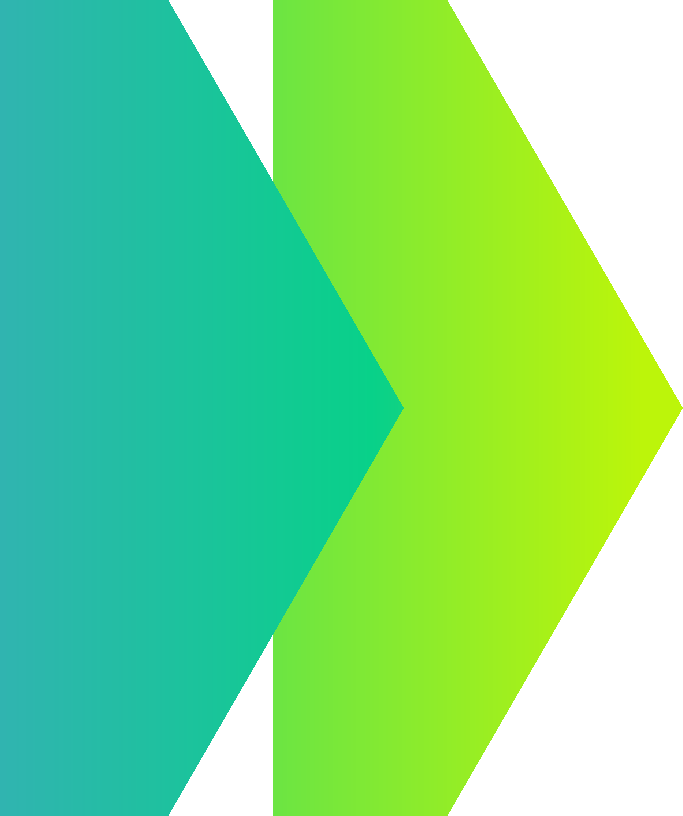
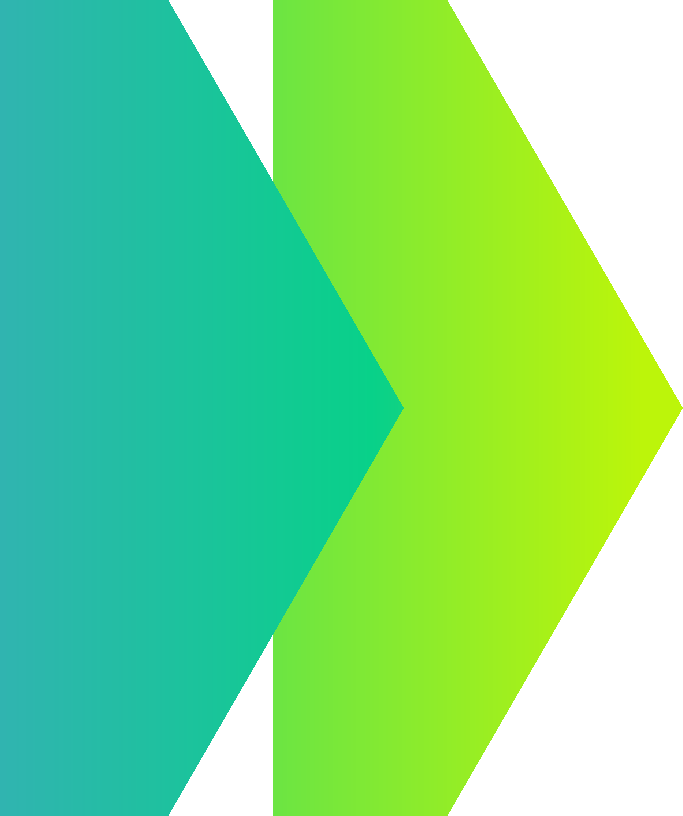
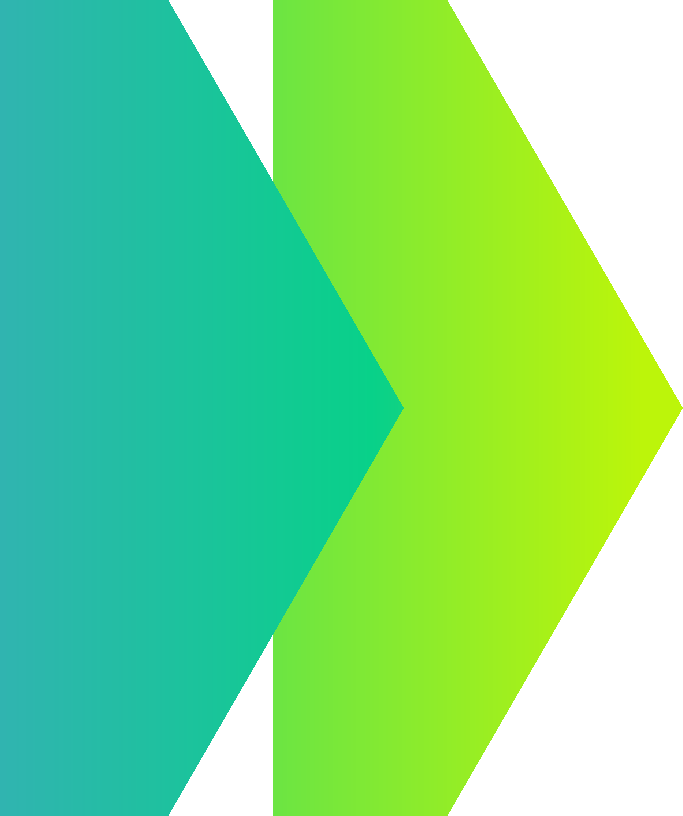

In [24]:
sd.reports(display=True)

In [25]:
# Create synthetic data
cond_syn_data = sd.data()
print(f"Created synthetic data with {cond_syn_data.shape[0]:,} records and {cond_syn_data.shape[1]:,} attributes")

Created synthetic data with 107,695 records and 19 attributes


In [26]:
cond_syn_data.to_csv('../generated_data/4_conditional_synthetic_data.csv', index=False)

5.2) Unconditional generation

In [27]:
sd2 = mostly.generate(g, size = len(tgt)*2) # no seed

Created synthetic dataset e3830ae0-00c9-4859-bada-4114e1516056 with generator bdf2b902-8426-4223-9369-79c736269cc9

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.

Explore MostlyAI report


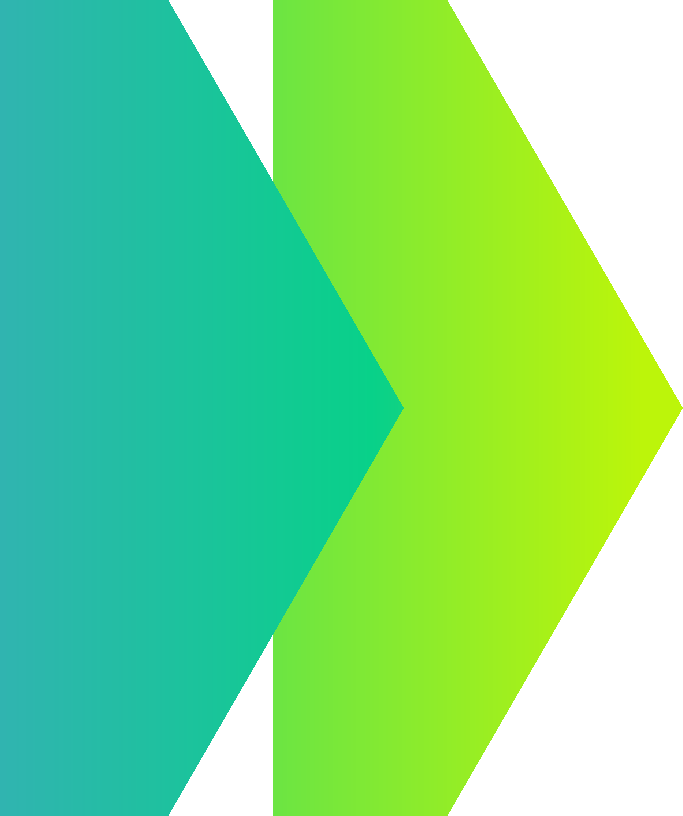
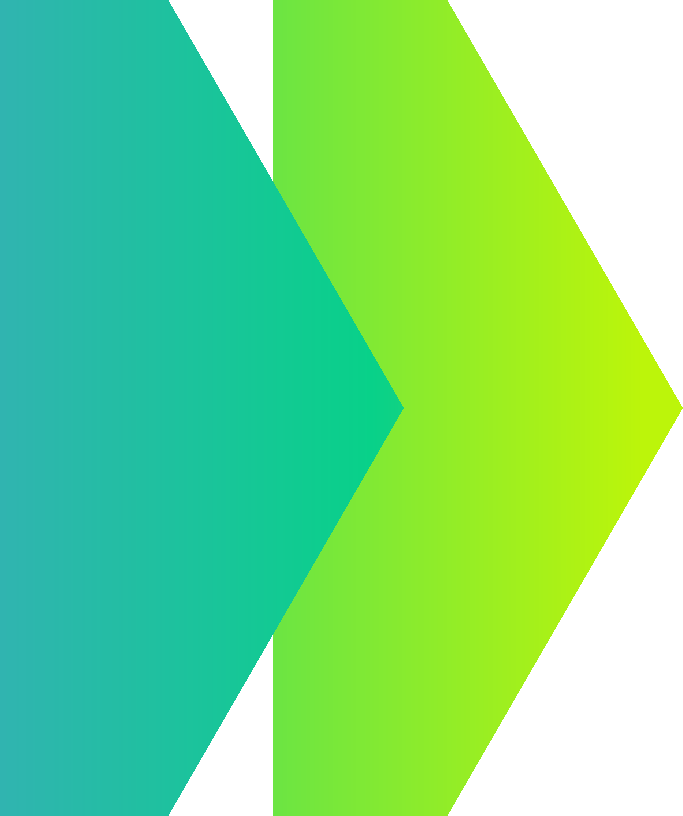
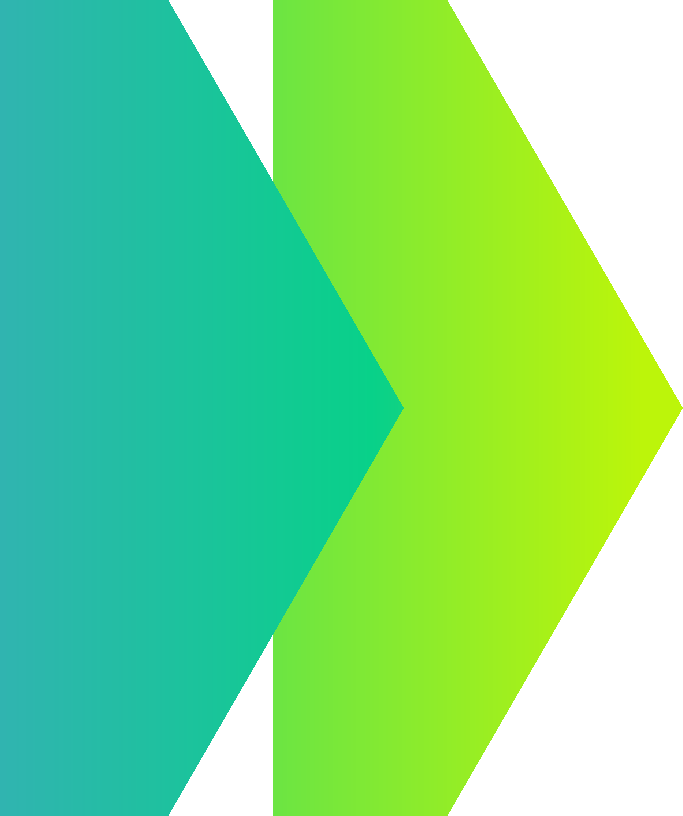

In [28]:
sd2.reports(display=True)

In [29]:
uncond_syn_data = sd2.data()
print(f"Created unconditional synthetic data with {uncond_syn_data.shape[0]:,} records and {uncond_syn_data.shape[1]:,} attributes")

Created unconditional synthetic data with 215,390 records and 19 attributes


In [30]:
uncond_syn_data.to_csv('../generated_data/4_unconditional_synthetic_data.csv', index=False)